In [3]:
import os
import librosa
import librosa.display
import IPython.display as ipd
import numpy as np
import matplotlib.pyplot as plt
import MIDI

/home/hina/.conda/envs/ai-gpu/lib/python3.8/site-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
/home/hina/.conda/envs/ai-gpu/lib/python3.8/site-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import of 'jit' requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit


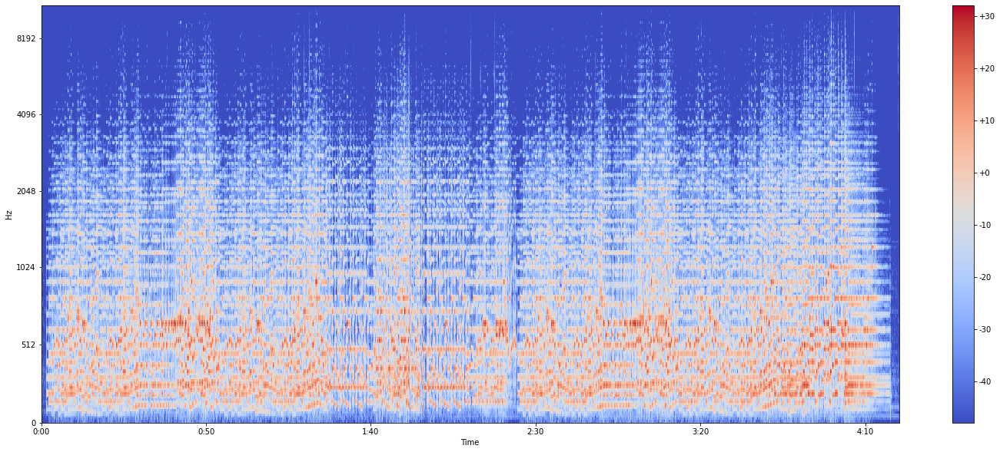

In [23]:
scale_file = "audio.wav"

scale, sr = librosa.load(scale_file)

mel = librosa.feature.melspectrogram(scale, sr=sr, n_mels=240)
lm = librosa.power_to_db(mel)
plt.figure(figsize=(25,10))
librosa.display.specshow(lm, x_axis='time', y_axis='mel', sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

In [20]:
cc = librosa.power_to_db(librosa.feature.mfcc(scale[:10000], sr=sr))

In [21]:
cc.shape

(20, 20)

/home/hina/.local/lib/python3.8/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
/home/hina/.local/lib/python3.8/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'linthreshy' parameter of __init__() has been renamed 'linthresh' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)


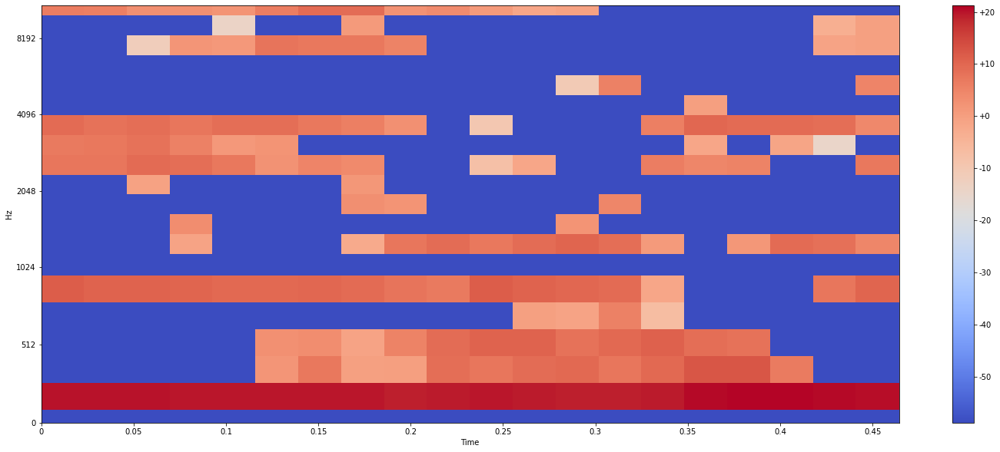

In [22]:
plt.figure(figsize=(25,10))
librosa.display.specshow(cc, x_axis='time', y_axis='mel', sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

In [27]:
mid_file = MIDI.MIDIFile("/media/hina/8TB (3.5' hub)/music/maestro-v3.0.0/2004/MIDI-Unprocessed_XP_08_R1_2004_01-02_ORIG_MID--AUDIO_08_R1_2004_01_Track01_wav.midi")

In [41]:
import magenta
from note_seq import midi_io

In [40]:
note_seq.

SyntaxError: invalid syntax (<ipython-input-40-ec0c012a5f60>, line 1)

In [37]:
!pip install note_seq

In [6]:
from note_seq import midi_io
r = midi_io.midi_file_to_note_sequence("trial1.mid")

In [7]:
for note in r.notes:
    print(note.start_time)
    print(note.pitch)

2.2409090909090907
51
2.2727272727272725
68
2.2409090909090907
56
2.7204545454545452
63
2.7204545454545452
51
3.5204545454545455
63
1.6318181818181818
44
3.5204545454545455
56
3.168181818181818
58
3.1363636363636362
39
3.840909090909091
51
3.8727272727272726
63
3.4886363636363633
68
3.1045454545454545
70
4.4795454545454545
51
4.159090909090909
46
3.840909090909091
72
4.4795454545454545
73
4.863636363636363
51
4.511363636363636
61
4.831818181818182
67
4.863636363636363
63
5.536363636363636
51
5.215909090909091
39
5.824999999999999
51
5.568181818181818
63
5.536363636363636
67
5.184090909090909
72
6.3999999999999995
51
6.431818181818182
56
6.3999999999999995
60
6.784090909090909
68
6.079545454545454
44
6.720454545454545
51
6.752272727272727
56
5.824999999999999
70
6.752272727272727
60
6.431818181818182
72
7.456818181818181
54
7.7749999999999995
54
7.456818181818181
56
7.488636363636363
60
7.456818181818181
68
7.1045454545454545
73
7.7749999999999995
75
7.072727272727272
39
8.5113636363636

In [1]:
from magenta.common import tf_utils
from note_seq import audio_io
from magenta.models.onsets_frames_transcription import audio_label_data_utils
from magenta.models.onsets_frames_transcription import configs
from magenta.models.onsets_frames_transcription import constants
from magenta.models.onsets_frames_transcription import data
from magenta.models.onsets_frames_transcription import infer_util
from magenta.models.onsets_frames_transcription import train_util
import note_seq
from note_seq import midi_io
from note_seq import sequences_lib

/home/hina/.conda/envs/ai-gpu/lib/python3.8/site-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
/home/hina/.conda/envs/ai-gpu/lib/python3.8/site-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import of 'jit' requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
SoX could not be found!

    If you do not have SoX, proceed here:
     - - - http://sox.sourceforge.net/ - - -

    If you do (or think that you should) have SoX, double-check your
   

In [66]:
dataFolder = "/media/hina/8TB (3.5' hub)/music/maestro-v3.0.0"

In [25]:
import glob
MAESTRO_CHECKPOINT_DIR = 'onsets-frames/maestro/train'

import tensorflow.compat.v1 as tf
import librosa
import numpy as np

from magenta.common import tf_utils
from note_seq import audio_io
from magenta.models.onsets_frames_transcription import audio_label_data_utils
from magenta.models.onsets_frames_transcription import configs
from magenta.models.onsets_frames_transcription import constants
from magenta.models.onsets_frames_transcription import data
from magenta.models.onsets_frames_transcription import infer_util
from magenta.models.onsets_frames_transcription import train_util
import note_seq
from note_seq import midi_io
from note_seq import sequences_lib



## Define model and load checkpoint
## Only needs to be run once.

config = configs.CONFIG_MAP['onsets_frames']
hparams = config.hparams
hparams.use_cudnn = False
hparams.batch_size = 1
checkpoint_dir = MAESTRO_CHECKPOINT_DIR

examples = tf.placeholder(tf.string, [None])

dataset = data.provide_batch(
    examples=examples,
    preprocess_examples=True,
    params=hparams,
    is_training=False,
    shuffle_examples=False,
    skip_n_initial_records=0)

estimator = train_util.create_estimator(
    config.model_fn, checkpoint_dir, hparams)

iterator = tf.data.make_initializable_iterator(dataset)
next_record = iterator.get_next()

ImportError: cannot import name 'create_example' from 'magenta.models.onsets_frames_transcription' (/home/hina/.conda/envs/ai-gpu/lib/python3.8/site-packages/magenta/models/onsets_frames_transcription/__init__.py)

In [22]:
fn = "audio2.wav"

import pyfluidsynth

f = open(fn, "rb")
from pathlib import Path
wav_data = f.read(Path(fn).stat().st_size)
f.close()
wav_data[0]

82

In [27]:
# example_list = list(
#   audio_label_data_utils.process_record(
#       wav_data=wav_data,
#       sample_rate=hparams.sample_rate,
#       ns=note_seq.NoteSequence(),
#       example_id=fn,
#       min_length=0,
#       max_length=-1,
#       allow_empty_notesequence=True))
# assert len(example_list) == 1

ns = note_seq.NoteSequence()
example_list = [audio_label_data_utils.create_example(fn, ns, wav_data, velocity_range=audio_label_data_utils.velocity_range_from_sequence(ns))]

to_process = [example_list[0].SerializeToString()]

print('Processing complete for', fn)
  
sess = tf.Session()

sess.run([
    tf.initializers.global_variables(),
    tf.initializers.local_variables()
])

sess.run(iterator.initializer, {examples: to_process})

def transcription_data(params):
  del params
  return tf.data.Dataset.from_tensors(sess.run(next_record))
input_fn = infer_util.labels_to_features_wrapper(transcription_data)

prediction_list = list(
    estimator.predict(
        input_fn,
        yield_single_examples=False))
assert len(prediction_list) == 1

sequence_prediction = note_seq.NoteSequence.FromString(
    prediction_list[0]['sequence_predictions'][0])

# Ignore warnings caused by pyfluidsynth
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 

note_seq.plot_sequence(sequence_prediction)
note_seq.play_sequence(sequence_prediction, note_seq.midi_synth.synthesize,
                 colab_ephemeral=False)

Processing complete for audio2.wav
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Running infer on CPU/GPU


/home/hina/.conda/envs/ai-gpu/lib/python3.8/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1719: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  warnings.warn('`layer.apply` is deprecated and '
/home/hina/.conda/envs/ai-gpu/lib/python3.8/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from onsets-frames/maestro/train/model.ckpt
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Calculating metrics for b'audio2.wav' with length 9597
INFO:tensorflow:Reference pitches were length 0, returning empty metrics for b'audio2.wav':
INFO:tensorflow:prediction_loop marked as finished
INFO:tensorflow:prediction_loop marked as finished


Loading BokehJS ...